<a href="https://colab.research.google.com/github/MousseRoyale/MousseRoyale/blob/main/MachineLearning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# COMP3010 Machine Learning- Assignment

In [122]:
#import libs and mount content drive
from google.colab import drive
drive.mount('/content/drive')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

import math
from math import sqrt


from sklearn import preprocessing
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score
from sklearn.model_selection import train_test_split, cross_val_predict
from sklearn.svm import SVR

from lightgbm import LGBMRegressor




import torch
import torch.nn as nn
import torch.autograd
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, SubsetRandomSampler


#Installations for first time running

#!pip install optuna

#!pip install pycaret
from pycaret.regression import *


#!pip install ydata-profiling
from ydata_profiling import ProfileReport






Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [123]:
#Write data to pd
df = pd.read_csv('/content/drive/MyDrive/MachineLearning/train.csv')
test = pd.read_csv('/content/drive/MyDrive/MachineLearning/test.csv')

# Exploratory Data Analysis

In [ ]:
#Check head
df.head()

,ID,Tank Failure Pressure (bar),Liquid Ratio (%),Tank Width (m),Tank Length (m),Tank Height (m),BLEVE Height (m),Vapour Height (m),Vapour Temperature (K),Liquid Temperature (K),...,Status,Liquid Critical Pressure (bar),Liquid Boiling Temperature (K),Liquid Critical Temperature (K),Sensor ID,Sensor Position Side,Sensor Position x,Sensor Position y,Sensor Position z,Target Pressure (bar)
10045,10244.0,36.91,0.64,1.58,9.39,0.58,1.01,0.22,442.31,299.28,...,Subcooled,37.9,NaN,152.0,12.0,2.0,18.75,-0.8,9.7,0.372254
10046,12758.0,16.44,0.55,0.80,5.58,1.99,1.60,0.82,293.54,285.02,...,Subcooled,37.9,-1.0,152.0,15.0,2.0,15.35,4.6,3.8,0.294822
10047,9438.0,36.26,0.57,2.38,2.62,2.80,0.60,1.19,349.75,418.53,...,Subcooled,37.9,-1.0,152.0,16.0,2.0,6.15,7.4,-1.0,1.392541
10048,8689.0,14.27,0.50,2.21,8.40,2.58,1.62,1.40,288.61,396.96,...,Superheated,37.9,-1.0,152.0,23.0,4.0,17.70,3.4,9.8,0.204026
10049,10302.0,35.52,0.63,1.60,7.21,1.60,1.00,0.59,436.28,309.79,...,Subcooled,42.5,-42.0,96.7,16.0,2.0,5.75,7.6,-1.1,0.980671


In [ ]:
#Check tail
df.tail()

,ID,Tank Failure Pressure (bar),Liquid Ratio (%),Tank Width (m),Tank Length (m),Tank Height (m),BLEVE Height (m),Vapour Height (m),Vapour Temperature (K),Liquid Temperature (K),...,Status,Liquid Critical Pressure (bar),Liquid Boiling Temperature (K),Liquid Critical Temperature (K),Sensor ID,Sensor Position Side,Sensor Position x,Sensor Position y,Sensor Position z,Target Pressure (bar)
10045,10244.0,36.91,0.64,1.58,9.39,0.58,1.01,0.22,442.31,299.28,...,Subcooled,37.9,NaN,152.0,12.0,2.0,18.75,-0.8,9.7,0.372254
10046,12758.0,16.44,0.55,0.80,5.58,1.99,1.60,0.82,293.54,285.02,...,Subcooled,37.9,-1.0,152.0,15.0,2.0,15.35,4.6,3.8,0.294822
10047,9438.0,36.26,0.57,2.38,2.62,2.80,0.60,1.19,349.75,418.53,...,Subcooled,37.9,-1.0,152.0,16.0,2.0,6.15,7.4,-1.0,1.392541
10048,8689.0,14.27,0.50,2.21,8.40,2.58,1.62,1.40,288.61,396.96,...,Superheated,37.9,-1.0,152.0,23.0,4.0,17.70,3.4,9.8,0.204026
10049,10302.0,35.52,0.63,1.60,7.21,1.60,1.00,0.59,436.28,309.79,...,Subcooled,42.5,-42.0,96.7,16.0,2.0,5.75,7.6,-1.1,0.980671


In [ ]:
#Check shape
df.shape

(10050, 25)

In [ ]:
#Check info
df.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,10045.0,8202.729119,2885.998522,3203.000000,5705.000000,8206.000000,10701.00000,13202.000000
Tank Failure Pressure (bar),10043.0,37.899252,225.634505,4.920000,13.730000,22.940000,32.19000,4995.616406
Liquid Ratio (%),10041.0,0.504288,0.228073,0.100000,0.300000,0.510000,0.70000,0.900000
Tank Width (m),10041.0,1.696627,0.764937,0.380000,1.010000,1.620000,2.39000,3.020000
Tank Length (m),10041.0,5.599281,2.596056,0.580000,3.380000,5.620000,7.81000,10.020000
Tank Height (m),10042.0,1.673800,0.751931,0.380000,1.010000,1.610000,2.39000,3.020000
BLEVE Height (m),10040.0,1.023503,0.575464,-0.020000,0.590000,1.010000,1.58000,2.020000
Vapour Height (m),10041.0,0.845691,0.536538,0.180000,0.400000,0.780000,1.20000,2.620000
Vapour Temperature (K),10022.0,396.755388,71.876848,281.210000,336.620000,386.725000,441.96500,573.300000
Liquid Temperature (K),10023.0,343.460330,35.536412,282.950000,312.810000,342.330000,365.32000,424.600000


In [ ]:
#find missing vals
df.isnull().sum()

ID                                  5
Tank Failure Pressure (bar)         7
Liquid Ratio (%)                    9
Tank Width (m)                      9
Tank Length (m)                     9
Tank Height (m)                     8
BLEVE Height (m)                   10
Vapour Height (m)                   9
Vapour Temperature (K)             28
Liquid Temperature (K)             27
Obstacle Distance to BLEVE (m)      8
Obstacle Width (m)                  6
Obstacle Height (m)                 6
Obstacle Thickness (m)              7
Obstacle Angle                      8
Status                              7
Liquid Critical Pressure (bar)     30
Liquid Boiling Temperature (K)     29
Liquid Critical Temperature (K)    30
Sensor ID                           8
Sensor Position Side                8
Sensor Position x                   7
Sensor Position y                   8
Sensor Position z                   9
Target Pressure (bar)              10
dtype: int64

In [ ]:
#percent of missing data
df.isnull().sum()/df.shape[0]*100

ID                                 0.049751
Tank Failure Pressure (bar)        0.069652
Liquid Ratio (%)                   0.089552
Tank Width (m)                     0.089552
Tank Length (m)                    0.089552
Tank Height (m)                    0.079602
BLEVE Height (m)                   0.099502
Vapour Height (m)                  0.089552
Vapour Temperature (K)             0.278607
Liquid Temperature (K)             0.268657
Obstacle Distance to BLEVE (m)     0.079602
Obstacle Width (m)                 0.059701
Obstacle Height (m)                0.059701
Obstacle Thickness (m)             0.069652
Obstacle Angle                     0.079602
Status                             0.069652
Liquid Critical Pressure (bar)     0.298507
Liquid Boiling Temperature (K)     0.288557
Liquid Critical Temperature (K)    0.298507
Sensor ID                          0.079602
Sensor Position Side               0.079602
Sensor Position x                  0.069652
Sensor Position y               

In [ ]:
#duplicate check
df.duplicated().sum()

50

In [ ]:
#Garbage value check
for i in df.select_dtypes(include="object").columns:
  print(df[i].value_counts())
  print("***"*100)

Status
Subcooled      6285
Superheated    3683
Subcool          23
subcooled        20
Subcoled         14
Superheat         8
superheated       6
Saperheated       4
Name: count, dtype: int64
************************************************************************************************************************************************************************************************************************************************************************************************************


In [ ]:
#Check categorical entries
df.describe(include="object")

,Status
count,10043
unique,8
top,Subcooled
freq,6285


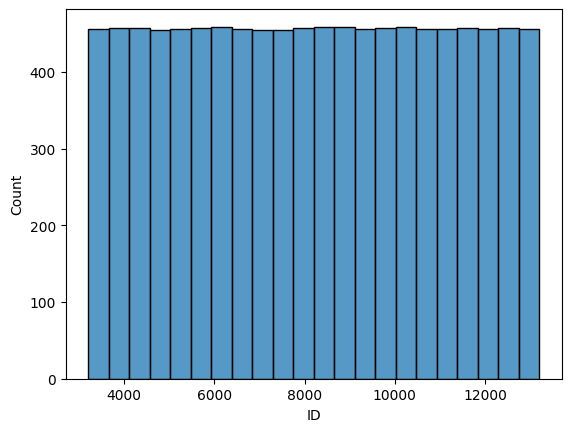

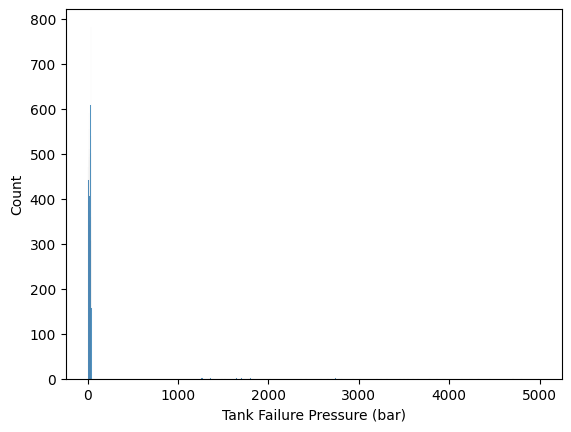

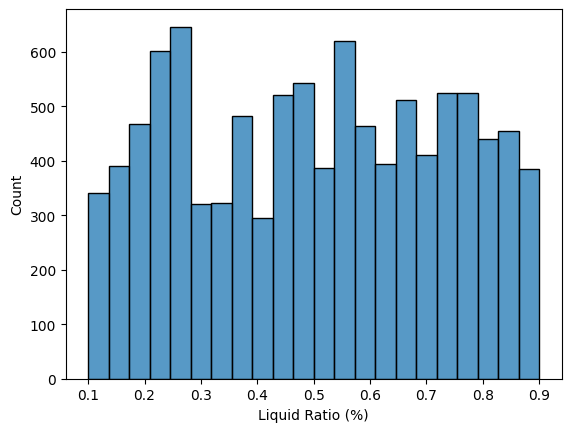

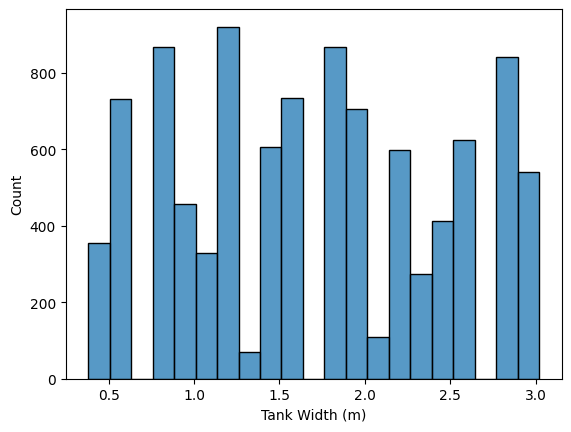

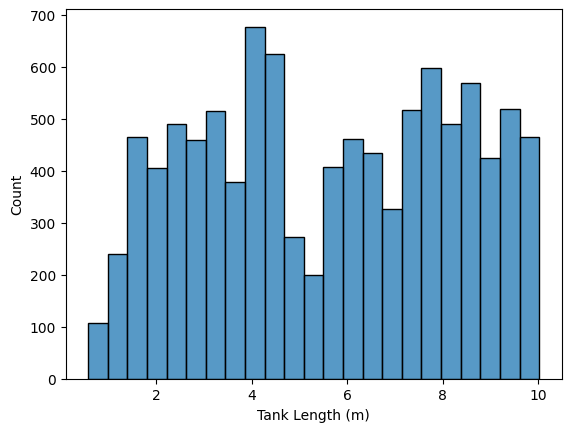

...

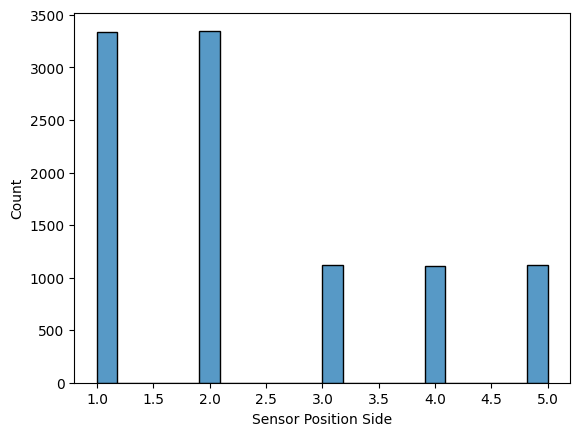

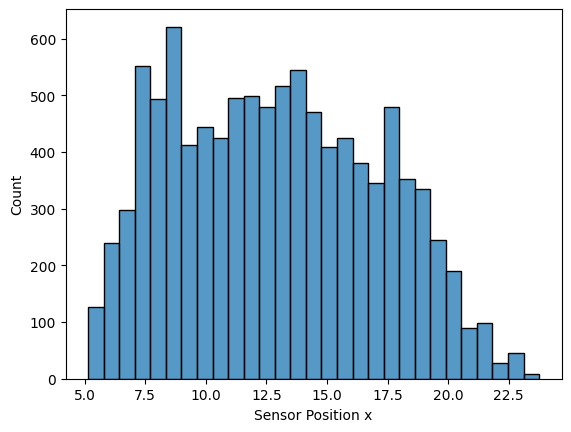

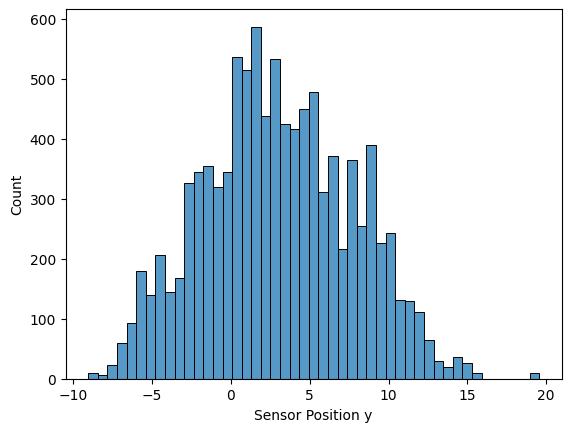

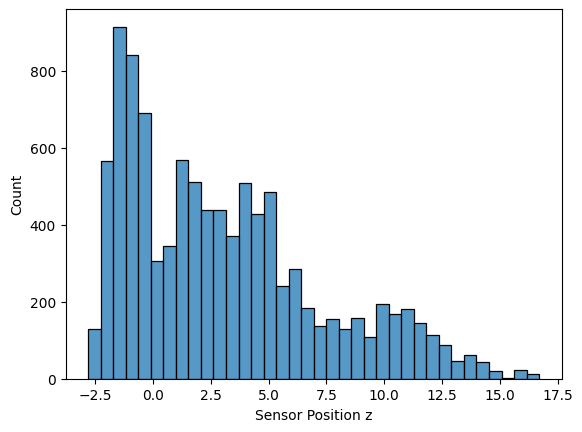

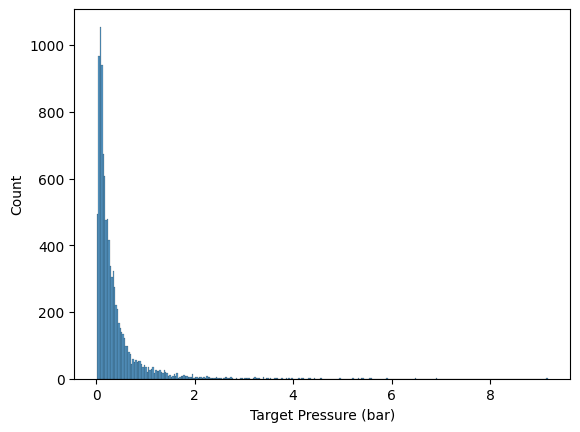

In [ ]:
#histogram to understand feature distribution
for i in df.select_dtypes(include="number").columns:
  sns.histplot(data=df, x=i)
  plt.show()

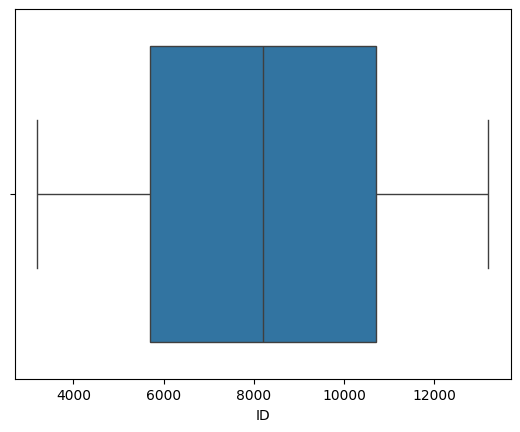

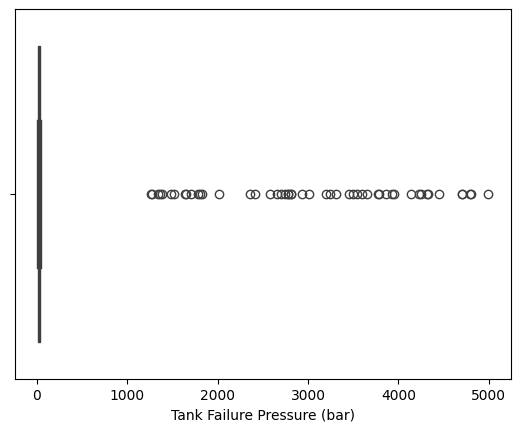

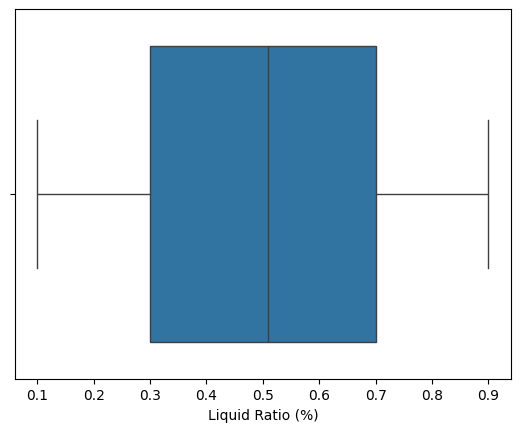

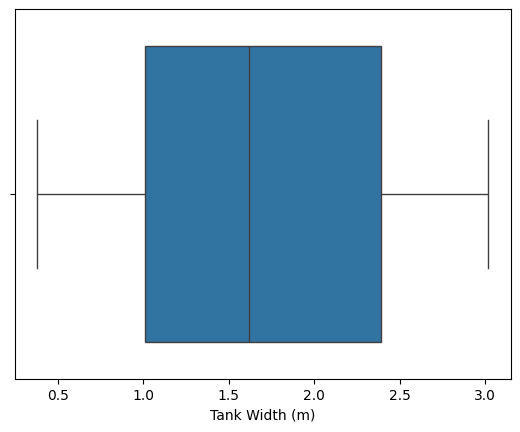

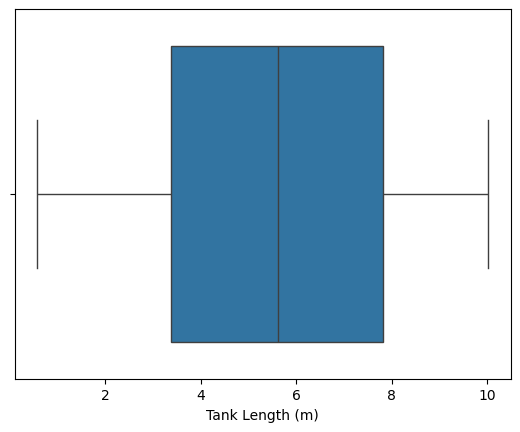

...

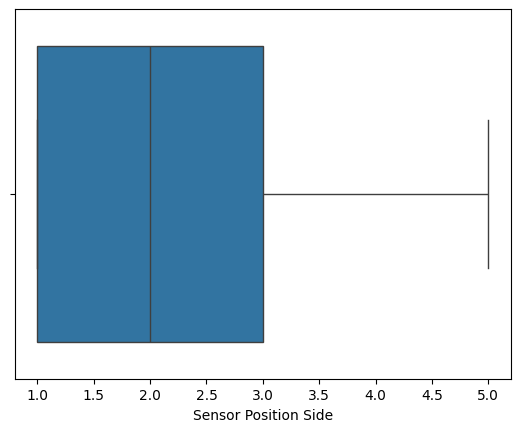

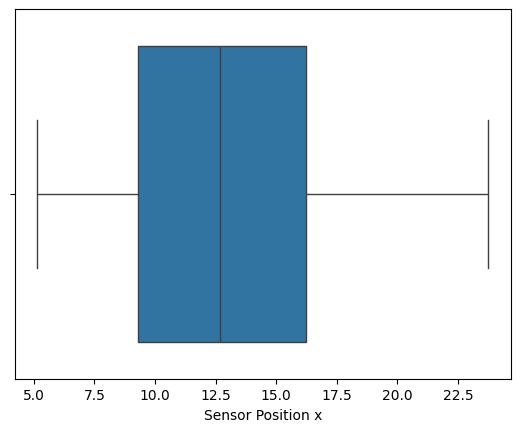

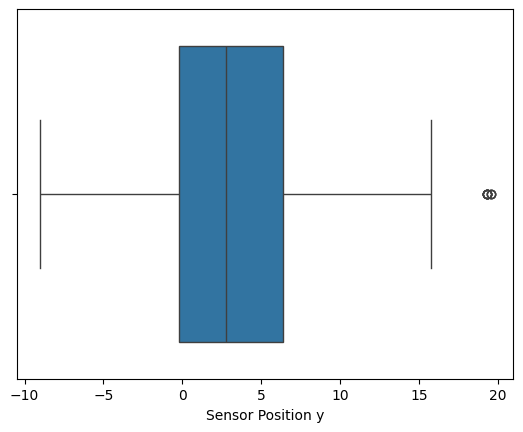

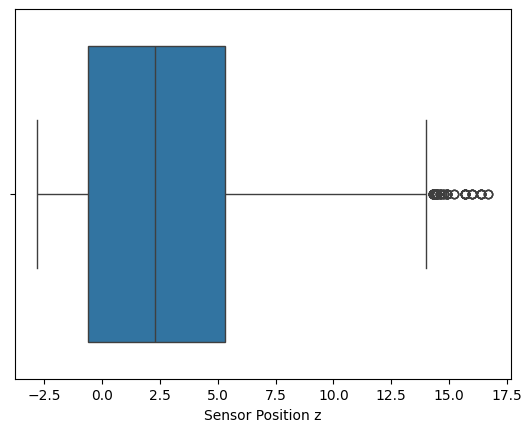

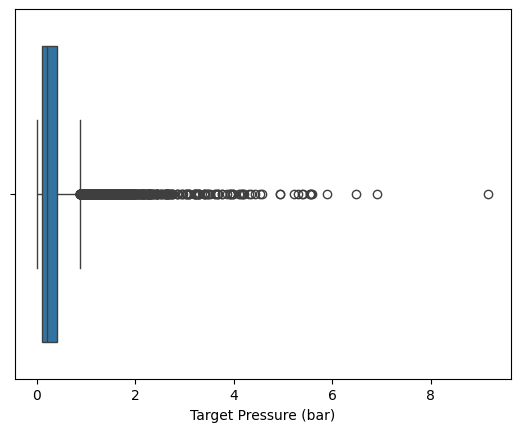

In [ ]:
#Boxplot for outlier detection
for i in df.select_dtypes(include="number").columns:
  sns.boxplot(data=df, x=i)
  plt.show()

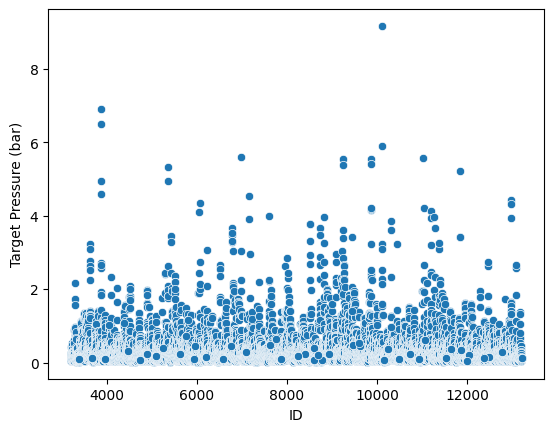

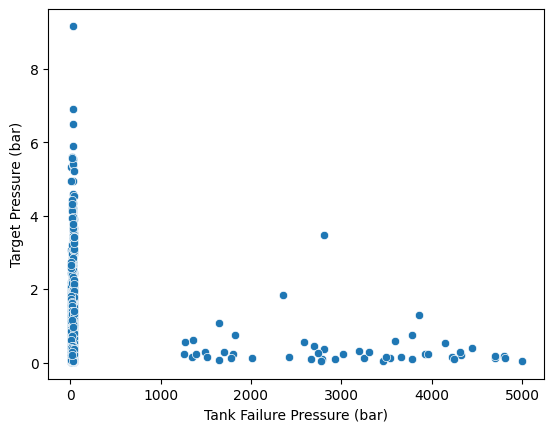

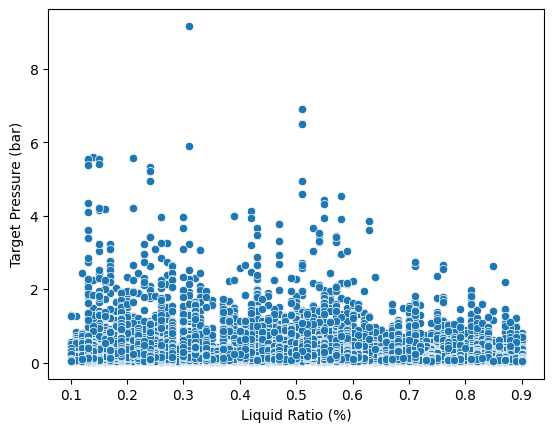

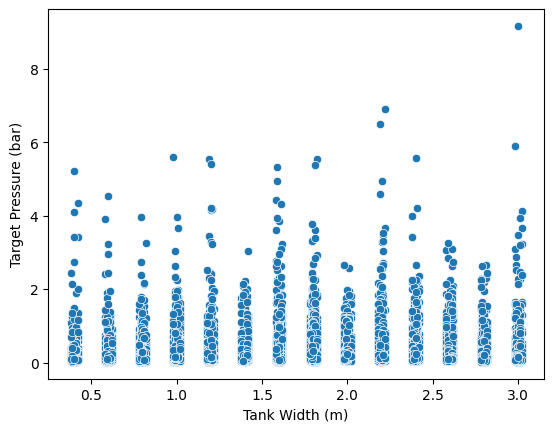

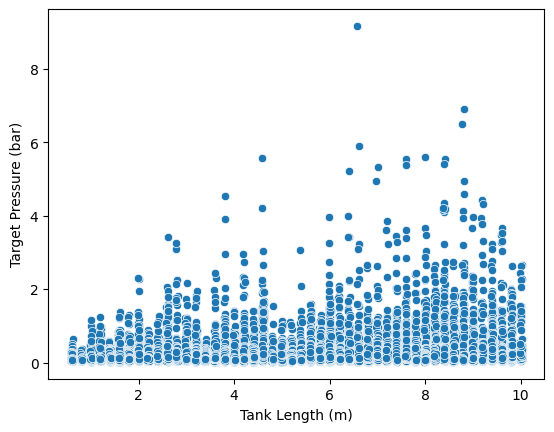

...

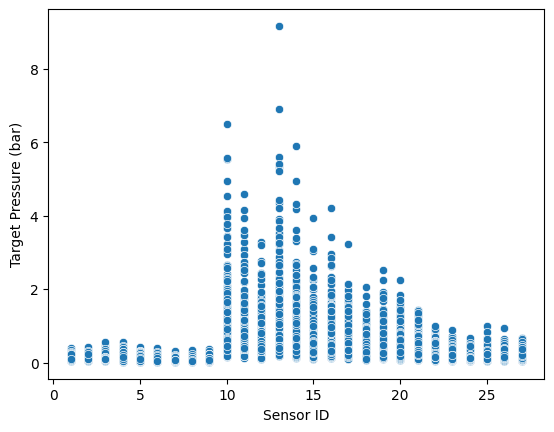

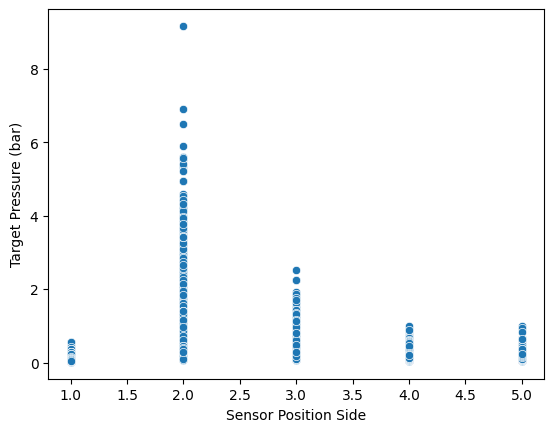

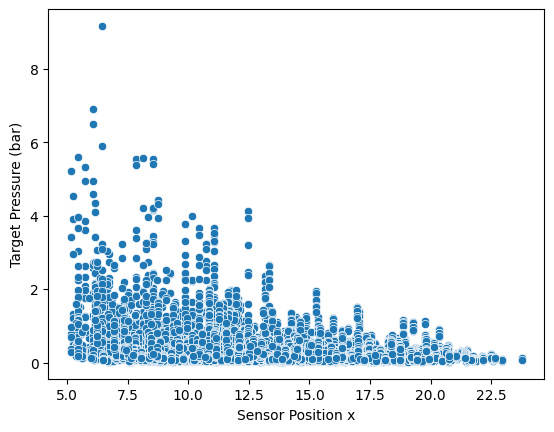

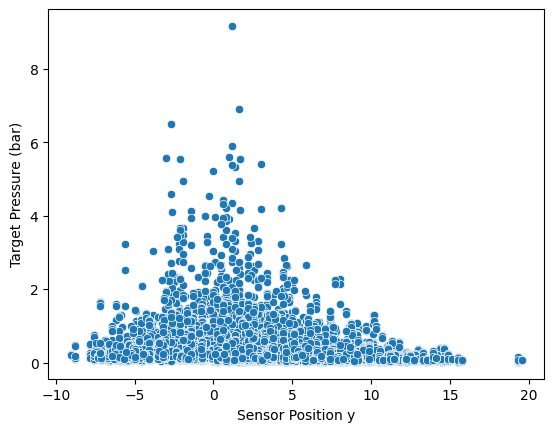

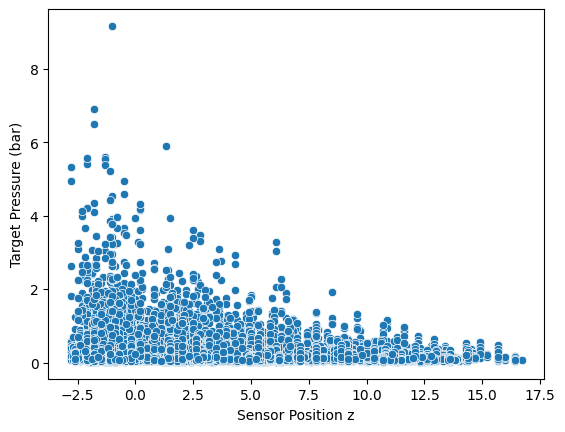

In [ ]:
#scatter plot for relationship with target
for i in ['ID', 'Tank Failure Pressure (bar)', 'Liquid Ratio (%)',
       'Tank Width (m)', 'Tank Length (m)', 'Tank Height (m)',
       'BLEVE Height (m)', 'Vapour Height (m)', 'Vapour Temperature (K)',
       'Liquid Temperature (K)', 'Obstacle Distance to BLEVE (m)',
       'Obstacle Width (m)', 'Obstacle Height (m)', 'Obstacle Thickness (m)',
       'Obstacle Angle', 'Liquid Critical Pressure (bar)',
       'Liquid Boiling Temperature (K)', 'Liquid Critical Temperature (K)',
       'Sensor ID', 'Sensor Position Side', 'Sensor Position x',
       'Sensor Position y', 'Sensor Position z']:
       sns.scatterplot(data=df,x=i,y='Target Pressure (bar)')
       plt.show()

<Axes: >

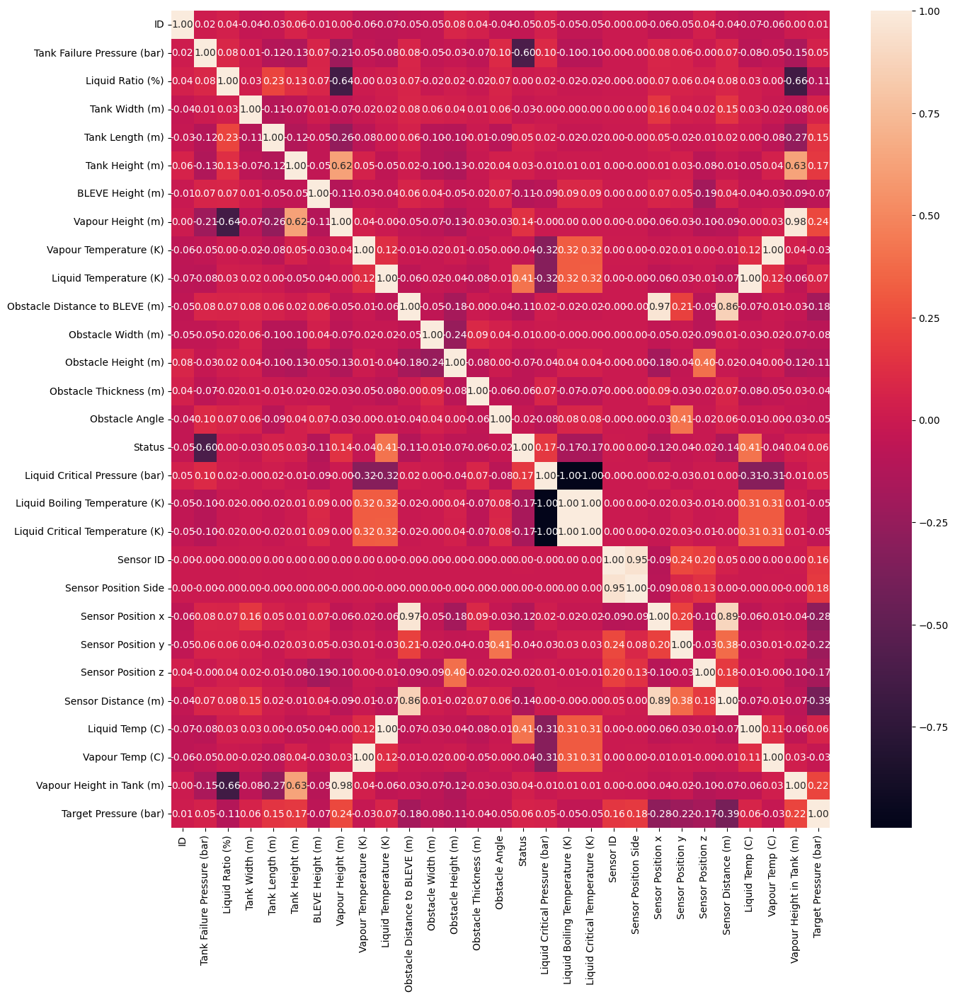

In [24]:
#correlation heatmap to interpret multicollinearity
s=df.select_dtypes(include="number").corr()
plt.figure(figsize=(15,15))
sns.heatmap(s,annot=True,fmt=".2f")

Here we can see multicollinearity and what features influence the target feature

In [ ]:
#Generate Report
profile = ProfileReport(df, title="Profile Report" ,explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Preprocessing

In [124]:
#Drop duplicates
rows_before, _ = df.shape
df.drop_duplicates(inplace=True)
rows_after, _ = df.shape
duplicates_dropped = rows_before - rows_after
#Verify
print("Number of duplicates dropped:", duplicates_dropped)

Number of duplicates dropped: 50


In [125]:
#Fix garbage values in "Status"
print(df["Status"].unique())
correction_map = {
    'Subcool': 'Subcooled',
    'subcooled': 'Subcooled',
    'Subcoled': 'Subcooled',
    'superheated': 'Superheated',
    'Superheat': 'Superheated',
    'Saperheated': 'Superheated'
}

df["Status"] = df["Status"].replace(correction_map)

#Verify
print(df["Status"].unique())

#Impute NaN for Status with mode (as it is discrete/categorical)
df['Status'].fillna(df['Status'].mode()[0], inplace=True)
#Verify
print(df["Status"].unique())

#Binay Encode
binary_encoding_map = {
    'Superheated': 1,
    'Subcooled': 0
}

test["Status"] = test["Status"].replace(binary_encoding_map)
df["Status"] = df["Status"].replace(binary_encoding_map)

# Verify the encoding
print(df["Status"].unique())



['Superheated' 'Subcooled' 'Subcool' 'subcooled' nan 'superheated'
 'Subcoled' 'Superheat' 'Saperheated']
['Superheated' 'Subcooled' nan]
['Superheated' 'Subcooled']
[1 0]


In [126]:
#Feature Engineering based on feature correlation, multicollinearity and mostly Prof Qilin Li's Papers

#Assuming 0,0,0 is BLEVE origin
df['Sensor Distance (m)'] = np.sqrt(df['Sensor Position x']**2 + df['Sensor Position y']**2 + df['Sensor Position z']**2)
df['Liquid Temp (C)'] = df['Liquid Temperature (K)'] - 273.15
df['Vapour Temp (C)'] = df['Vapour Temperature (K)'] - 273.15
# Redundant? df['Vapour Height in Tank (m)'] = df['Tank Height (m)'] * (1- df['Liquid Ratio (%)'])

#Calculate for test
test['Sensor Distance (m)'] = np.sqrt(test['Sensor Position x']**2 + test['Sensor Position y']**2 + test['Sensor Position z']**2)
test['Liquid Temp (C)'] = test['Liquid Temperature (K)'] - 273.15
test['Vapour Temp (C)'] = test['Vapour Temperature (K)'] - 273.15


df.head().T

,0,1,2,3,4
ID,3203.000000,3204.000000,3205.000000,3206.000000,3207.000000
Tank Failure Pressure (bar),7.320000,7.180000,7.320000,7.260000,7.320000
Liquid Ratio (%),0.420000,0.420000,0.410000,0.420000,0.420000
Tank Width (m),2.420000,2.390000,2.390000,2.400000,2.400000
Tank Length (m),5.390000,5.390000,5.380000,5.410000,5.410000
Tank Height (m),1.000000,1.010000,1.000000,1.000000,1.020000
BLEVE Height (m),1.790000,1.810000,1.780000,1.810000,1.790000
Vapour Height (m),0.600000,0.590000,0.620000,0.610000,0.620000
Vapour Temperature (K),524.610000,522.800000,523.000000,522.350000,522.980000
Liquid Temperature (K),354.490000,354.310000,354.590000,354.370000,354.330000


In [127]:
#Impute Missing Values - Median
for i in df.select_dtypes(include="number"):
    if df[i].isnull().any():
        df[i].fillna(df[i].median(), inplace=True)

In [128]:
#Drops outliers beyond 3 sds
df = df[(np.abs(stats.zscore(df)) < 3).all(axis=1)]

In [129]:
# Identify skewed features
skewed_features = df.columns[df.columns != "Target Pressure (bar)"]

#Yeo-Johnson to normalise
pt = PowerTransformer(method='yeo-johnson', standardize=False)
pt.fit(df[skewed_features])

# Transform both training and test data
df[skewed_features] = pt.transform(df[skewed_features])
test[skewed_features] = pt.transform(test[skewed_features])

# Ensure no transformation for Target Pressure (bar)
df["Target Pressure (bar)"] = df["Target Pressure (bar)"]

In [130]:
#Scaling - Robust Scaler
scale_df = df.copy()
scale_test= test.copy()

# Initialize RobustScaler
scaler = RobustScaler()

# Fit and transform the scaler on both scaled_test and scaled_df
scaled_test = scaler.fit_transform(scale_test)
scaled_df = scaler.fit_transform(scale_df.drop(columns=["Target Pressure (bar)"]))

# Convert scaled arrays back to dataframes
scaled_test = pd.DataFrame(scaled_test, columns=scale_test.columns, index=scale_test.index)
scaled_df = pd.DataFrame(scaled_df, columns=scale_df.drop(columns=["Target Pressure (bar)"]).columns, index=scale_df.index)

# Set test_data to the new scaled_test
test = scaled_test

# Set df to the new scaled_df but keep the old "Target Pressure (bar)" values
scaled_df["Target Pressure (bar)"] = scale_df["Target Pressure (bar)"]
df = scaled_df

# Support Vector Regression

In [120]:
# Prepare dataset
X = df.drop(columns=['Target Pressure (bar)']).values
y = df['Target Pressure (bar)'].values

# Split dataset 80/20 split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Build SVR
svr = SVR()

# cross-validation to evaluate
y_pred_train = cross_val_predict(svr, X_train, y_train, cv=5)

# Train the SVR model
svr.fit(X_train, y_train)

# Make predictions on test data
test_predictions = svr.predict(X_test)

# Calculate evaluation metrics for training data
train_mse = mean_squared_error(y_train, y_pred_train)
train_mape = mean_absolute_percentage_error(y_train, y_pred_train)
train_r2 = r2_score(y_train, y_pred_train)

print("Training Metrics:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"Mean Absolute Percentage Error (MAPE): {train_mape}")
print(f"R^2 Score: {train_r2}")

# Calculate evaluation metrics for test data
test_mse = mean_squared_error(y_test, test_predictions)
test_mape = mean_absolute_percentage_error(y_test, test_predictions)
test_r2 = r2_score(y_test, test_predictions)

print("\nTesting Metrics:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"Mean Absolute Percentage Error (MAPE): {test_mape}")
print(f"R^2 Score: {test_r2}")

#Run the model on the test data
test_predictions_final = svr.predict(test)
predictions_df = pd.DataFrame({'ID': range(len(test_predictions_final)), 'Target Pressure (bar)': test_predictions_final})
predictions_df.to_csv('SVR.csv', index=False)


Training Metrics:
Mean Squared Error (MSE): 0.01364614898108967
Mean Absolute Percentage Error (MAPE): 0.4398371259553809
R^2 Score: 0.8635014772461199

Testing Metrics:
Mean Squared Error (MSE): 0.013037951240068804
Mean Absolute Percentage Error (MAPE): 0.45230574894600695
R^2 Score: 0.86244261284564


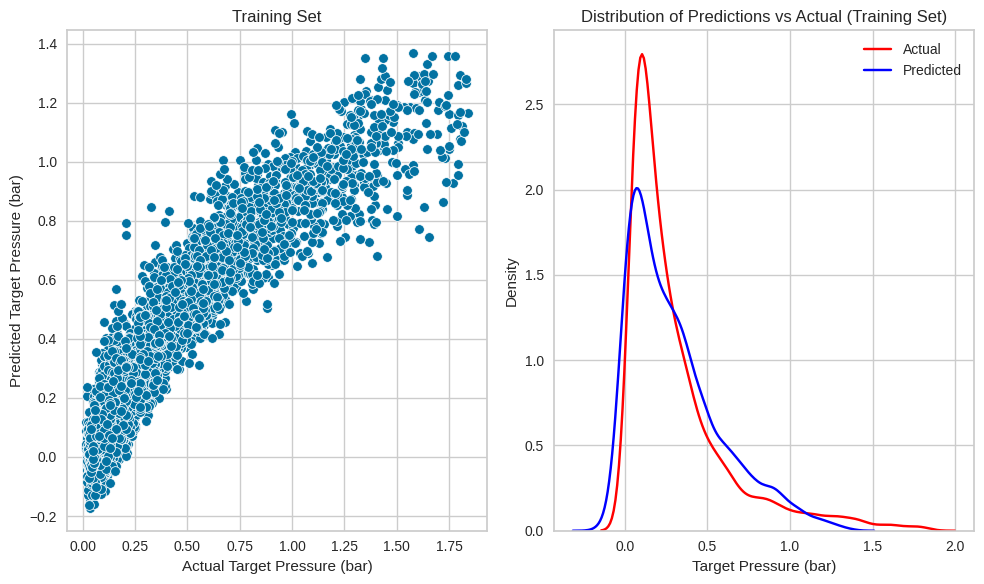

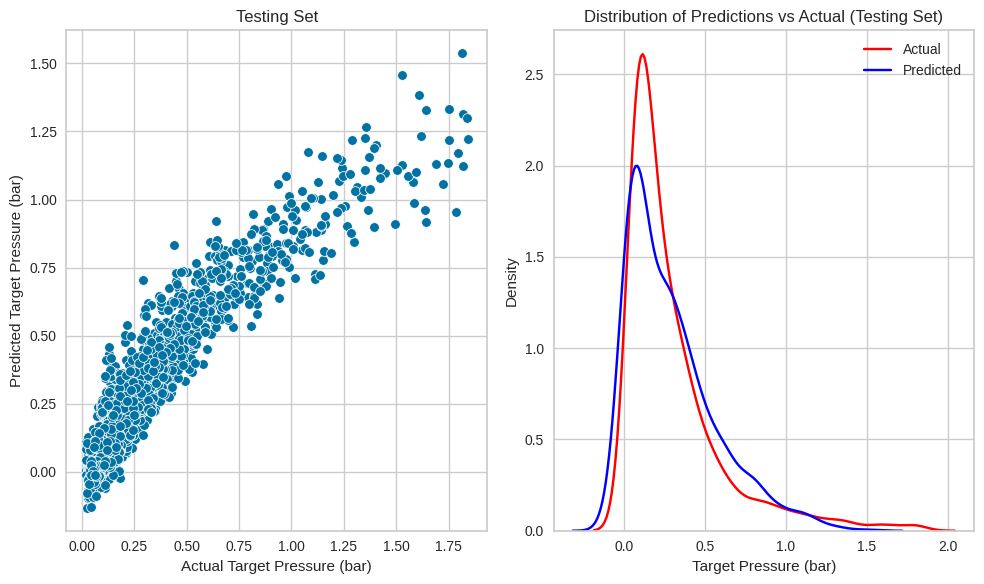

In [121]:
#Plot predictions for training set
plt.figure(figsize=(10, 6))
plt.subplot(1, 2, 1)
sns.scatterplot(x=y_train, y=y_pred_train)
plt.xlabel('Actual Target Pressure (bar)')
plt.ylabel('Predicted Target Pressure (bar)')
plt.title('Training Set')

plt.subplot(1, 2, 2)
sns.distplot(y_train, hist=False, color="red", label="Actual")
sns.distplot(y_pred_train, hist=False, color="blue", label="Predicted")
plt.xlabel('Target Pressure (bar)')
plt.ylabel('Density')
plt.title('Distribution of Predictions vs Actual (Training Set)')
plt.legend()

plt.tight_layout()
plt.show()

#Plot predictions for testing set
plt.figure(figsize=(10, 6))
plt.subplot(1, 2, 1)
sns.scatterplot(x=y_test, y=test_predictions)
plt.xlabel('Actual Target Pressure (bar)')
plt.ylabel('Predicted Target Pressure (bar)')
plt.title('Testing Set')

plt.subplot(1, 2, 2)
sns.distplot(y_test, hist=False, color="red", label="Actual")
sns.distplot(test_predictions, hist=False, color="blue", label="Predicted")
plt.xlabel('Target Pressure (bar)')
plt.ylabel('Density')
plt.title('Distribution of Predictions vs Actual (Testing Set)')
plt.legend()

plt.tight_layout()
plt.show()


# LightGBM

In [132]:
X = df.drop(columns=['Target Pressure (bar)'])
y = df['Target Pressure (bar)']

#Split the data 80/20
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Best Hyperparameters provided
best_params = {'num_leaves': 96, 'learning_rate': 0.10898527110043835, 'min_child_weight': 0.0018455265533900817, 'min_child_samples': 14, 'subsample': 0.9914203002246921, 'colsample_bytree': 0.9183801605274873, 'reg_lambda': 0.007880445343867093}
print("Best Hyperparameters:", best_params)

#Train LightGBM model with hyperparameters
best_model = LGBMRegressor(**best_params, n_estimators=2000)

best_model.fit(X_train, y_train,
               eval_set=[(X_test, y_test)],
               eval_metric='mape',)

#Predictions on train set
train_predictions = best_model.predict(X_train)

#Calculate train MAPE and R^2
train_mape = mean_absolute_percentage_error(y_train, train_predictions)
train_r2 = r2_score(y_train, train_predictions)

print("Train MAPE:", train_mape)
print("Train R^2:", train_r2)

#Predictions on test set
test_predictions = best_model.predict(X_test)

#Calculate test MAPE and R^2
test_mape = mean_absolute_percentage_error(y_test, test_predictions)
test_r2 = r2_score(y_test, test_predictions)

print("Test MAPE:", test_mape)
print("Test R^2:", test_r2)

#Make predictions on the actual test set
test_X_predictions = best_model.predict(test)

test_X_predictions_df = pd.DataFrame({'ID': range(len(test_X_predictions)), 'prediction_label': test_X_predictions})
test_X_predictions_df.to_csv('lightgbm.csv', index=False)


Best Hyperparameters: {'num_leaves': 96, 'learning_rate': 0.10898527110043835, 'min_child_weight': 0.0018455265533900817, 'min_child_samples': 14, 'subsample': 0.9914203002246921, 'colsample_bytree': 0.9183801605274873, 'reg_lambda': 0.007880445343867093}
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004559 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3219
[LightGBM] [Info] Number of data points in the train set: 7749, number of used features: 27
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 0.312828
Train MAPE: 0.00014447938032623452
Train R^2: 0.999999987928603
Test MAPE: 0.12904685614054023
Test R^2: 0.9541921170445853


If you note the train vs test scores. You can see how overfit the model is.

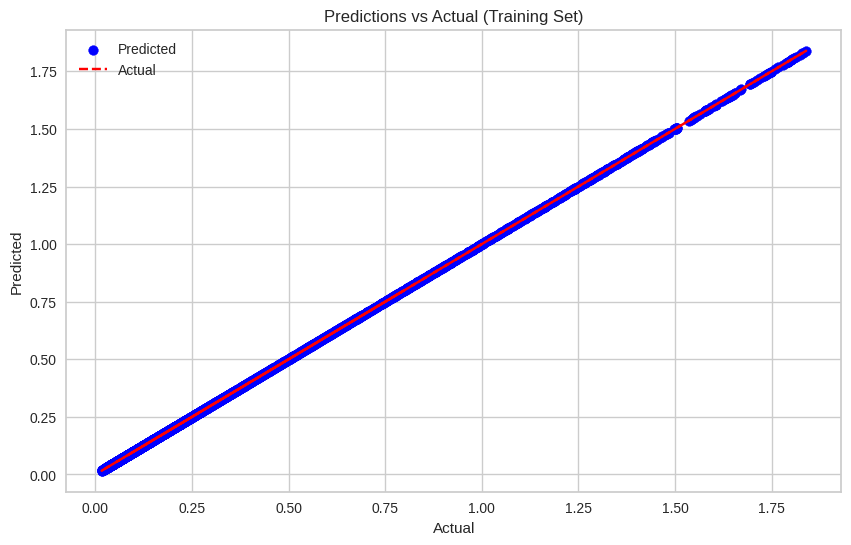

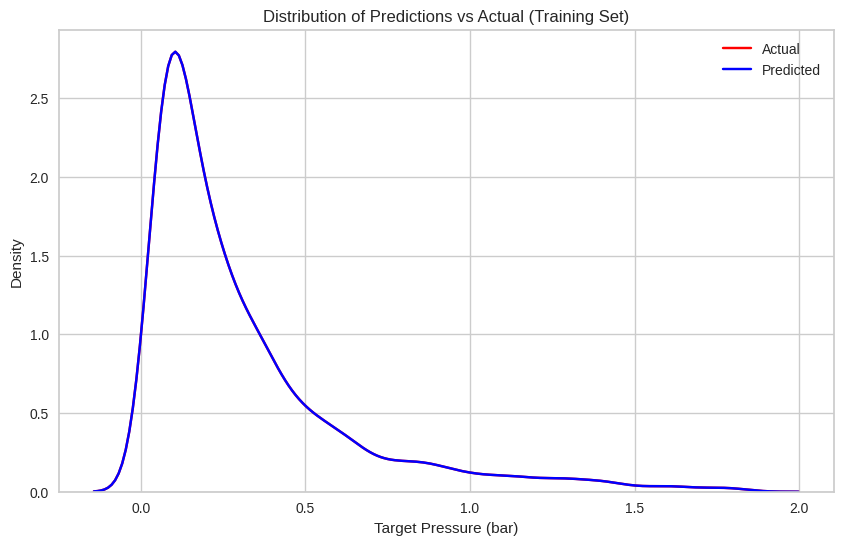

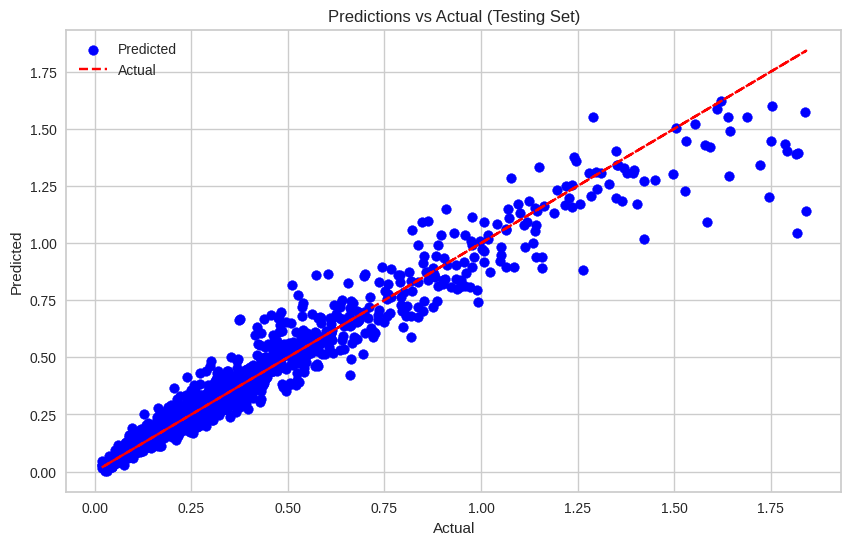

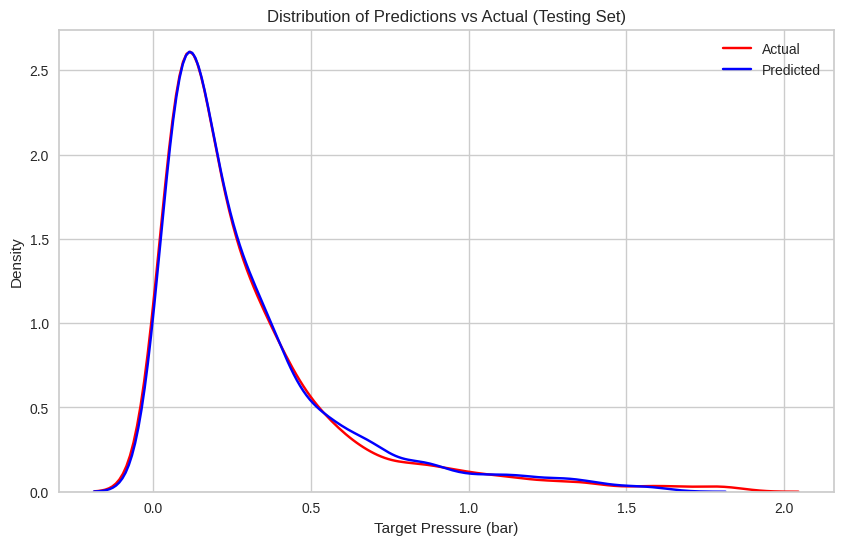

In [133]:

#Plot predictions for training set
plt.figure(figsize=(10, 6))
plt.scatter(y_train, train_predictions, color='blue', label='Predicted')
plt.plot(y_train, y_train, color='red', linestyle='--', label='Actual')
plt.title('Predictions vs Actual (Training Set)')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.legend()
plt.show()


plt.figure(figsize=(10, 6))
sns.distplot(y_train, hist=False, color="red", label="Actual")
sns.distplot(train_predictions, hist=False, color="blue", label="Predicted")
plt.title('Distribution of Predictions vs Actual (Training Set)')
plt.xlabel('Target Pressure (bar)')
plt.ylabel('Density')
plt.legend()
plt.show()

#Plot predictions for testing set
plt.figure(figsize=(10, 6))
plt.scatter(y_test, test_predictions, color='blue', label='Predicted')
plt.plot(y_test, y_test, color='red', linestyle='--', label='Actual')
plt.title('Predictions vs Actual (Testing Set)')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
sns.distplot(y_test, hist=False, color="red", label="Actual")
sns.distplot(test_predictions, hist=False, color="blue", label="Predicted")
plt.title('Distribution of Predictions vs Actual (Testing Set)')
plt.xlabel('Target Pressure (bar)')
plt.ylabel('Density')
plt.legend()
plt.show()


# Artificial Neural Network - MLP


In [44]:
 #Define NN architecture
class ANN(nn.Module):
    def __init__(self):
        super(ANN, self).__init__()
        self.fc1 = nn.Linear(27, 256)
        self.fc2 = nn.Linear(256, 256)
        self.fc3 = nn.Linear(256, 256)
        self.fc4 = nn.Linear(256, 1)
        self.dropout = nn.Dropout(0.1)

    def forward(self, x):
        x = torch.nn.functional.mish(self.fc1(x))
        x = self.dropout(x)
        x = torch.nn.functional.mish(self.fc2(x))
        x = self.dropout(x)
        x = torch.nn.functional.mish(self.fc3(x))
        x = self.dropout(x)
        x = torch.nn.functional.softplus(self.fc4(x))
        return x

# Prepare the dataset
X = df.drop(columns=['Target Pressure (bar)']).values
y = df['Target Pressure (bar)'].values

# Convert numpy arrays to PyTorch tensors
X_tensor = torch.tensor(X, dtype=torch.float32)
y_tensor = torch.tensor(y, dtype=torch.float32).view(-1, 1)

# Define the neural network model
model = ANN()

# Define the loss function MAPE
def mape_loss(output, target):
    return torch.mean(torch.abs((output - target) / target))

# Define optimiser SGD
optimizer = optim.SGD(model.parameters(), lr=0.1, momentum=0.9)

#Define L2 regularization
l2_lambda = 1e-5
l2_reg = 0.0

#Specify L2 for each parameter
for param in model.parameters():
    l2_reg += torch.norm(param)

#Define loss function including L2
def loss_function(output, target):
    mape = mape_loss(output, target)
    l2_loss = l2_lambda * l2_reg
    return mape + l2_loss


#Split the data into training, validation, and testing 70/15/15
dataset = TensorDataset(X_tensor, y_tensor)
dataset_size = len(dataset)
indices = list(range(dataset_size))
split1 = int(0.7 * dataset_size)
split2 = int(0.85 * dataset_size)
train_indices, val_indices, test_indices = indices[:split1], indices[split1:split2], indices[split2:]

#Define samplers for each subset of data
train_sampler = SubsetRandomSampler(train_indices)
val_sampler = SubsetRandomSampler(val_indices)
test_sampler = SubsetRandomSampler(test_indices)

#Define data loaders for each subset of data
train_loader = DataLoader(dataset, batch_size=64, sampler=train_sampler)
val_loader = DataLoader(dataset, batch_size=64, sampler=val_sampler)
test_loader = DataLoader(dataset, batch_size=64, sampler=test_sampler)

#Epoch num
epochs = 500

# Initialize lists to store metrics for each data split
train_mse_list, val_mse_list, test_mse_list = [], [], []
train_mape_list, val_mape_list, test_mape_list = [], [], []
train_r2_list, val_r2_list, test_r2_list = [], [], []

#Training loop
for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)

        # Compute L2 regularization for each parameter
        l2_reg = 0.0
        for param in model.parameters():
            l2_reg += torch.norm(param)

        loss = loss_function(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

    #Validation
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for inputs, labels in val_loader:
            outputs = model(inputs)
            val_loss += loss_function(outputs, labels).item()

    #Evaluation on training set
    model.eval()
    train_predictions = []
    train_true_values = []
    with torch.no_grad():
        for inputs, labels in train_loader:
            outputs = model(inputs)
            train_predictions.extend(outputs.numpy())
            train_true_values.extend(labels.numpy())

    #Evaluation on validation set
    val_predictions = []
    val_true_values = []
    with torch.no_grad():
        for inputs, labels in val_loader:
            outputs = model(inputs)
            val_predictions.extend(outputs.numpy())
            val_true_values.extend(labels.numpy())

    #Evaluation on testing set
    test_predictions = []
    test_true_values = []
    with torch.no_grad():
        for inputs, labels in test_loader:
            outputs = model(inputs)
            test_predictions.extend(outputs.numpy())
            test_true_values.extend(labels.numpy())

    #Calculate MSE, MAPE, and R^2 for each split
    train_mse = mean_squared_error(train_true_values, train_predictions)
    val_mse = mean_squared_error(val_true_values, val_predictions)
    test_mse = mean_squared_error(test_true_values, test_predictions)

    train_mse_list.append(train_mse)
    val_mse_list.append(val_mse)
    test_mse_list.append(test_mse)

    #Calculate MAPE (Mean Absolute Percentage Error)
    train_mape = mean_absolute_percentage_error(train_true_values, train_predictions)
    val_mape = mean_absolute_percentage_error(val_true_values, val_predictions)
    test_mape = mean_absolute_percentage_error(test_true_values, test_predictions)

    train_mape_list.append(train_mape)
    val_mape_list.append(val_mape)
    test_mape_list.append(test_mape)

    #Calculate R^2 score
    train_r2 = r2_score(train_true_values, train_predictions)
    val_r2 = r2_score(val_true_values, val_predictions)
    test_r2 = r2_score(test_true_values, test_predictions)

    train_r2_list.append(train_r2)
    val_r2_list.append(val_r2)
    test_r2_list.append(test_r2)

    print(f'Epoch {epoch+1}/{epochs}, Training Loss: {running_loss/len(train_loader)}, Validation Loss: {val_loss/len(val_loader)}')

#Calculate average metrics
avg_train_mse = sum(train_mse_list) / len(train_mse_list)
avg_val_mse = sum(val_mse_list) / len(val_mse_list)
avg_test_mse = sum(test_mse_list) / len(test_mse_list)

avg_train_mape = sum(train_mape_list) / len(train_mape_list)
avg_val_mape = sum(val_mape_list) / len(val_mape_list)
avg_test_mape = sum(test_mape_list) / len(test_mape_list)

avg_train_r2 = sum(train_r2_list) / len(train_r2_list)
avg_val_r2 = sum(val_r2_list) / len(val_r2_list)
avg_test_r2 = sum(test_r2_list) / len(test_r2_list)


print(f'Average Training MSE: {avg_train_mse}, Average Validation MSE: {avg_val_mse}, Average Testing MSE: {avg_test_mse}')
print(f'Average Training MAPE: {avg_train_mape}, Average Validation MAPE: {avg_val_mape}, Average Testing MAPE: {avg_test_mape}')
print(f'Average Training R^2: {avg_train_r2}, Average Validation R^2: {avg_val_r2}, Average Testing R^2: {avg_test_r2}')

Epoch 1/500, Training Loss: 1.0486656343037228, Validation Loss: 1.0001462024191152
Epoch 2/500, Training Loss: 0.9998719000591422, Validation Loss: 0.9992627553317858
Epoch 3/500, Training Loss: 0.9960763055198597, Validation Loss: 0.9995656324469525
Epoch 4/500, Training Loss: 0.9341826312384516, Validation Loss: 0.4919786647610042
Epoch 5/500, Training Loss: 0.4556068991715053, Validation Loss: 0.40012830107108405
Epoch 6/500, Training Loss: 0.4018064054115763, Validation Loss: 0.32716234352277673
Epoch 7/500, Training Loss: 0.34022958843775514, Validation Loss: 0.2981921181730602
Epoch 8/500, Training Loss: 0.27219969807368405, Validation Loss: 0.2215912102357201
Epoch 9/500, Training Loss: 0.2340023805791477, Validation Loss: 0.277590741281924
Epoch 10/500, Training Loss: 0.2390129082607773, Validation Loss: 0.2563359484724376
Epoch 11/500, Training Loss: 0.23458849287258005, Validation Loss: 0.23851541203001272
Epoch 12/500, Training Loss: 0.22100083305026, Validation Loss: 0.220

In [45]:
# Convert the test data to PyTorch tensor
X_test = torch.tensor(test.values, dtype=torch.float32)

# Set the model to evaluation mode
model.eval()

# Make predictions on the test data
with torch.no_grad():
    predictions = model(X_test).numpy()

# Flatten the predictions array
predictions_flat = predictions.flatten()

# Create a DataFrame to store predictions
predictions_df = pd.DataFrame({'ID': range(len(predictions_flat)), 'Target Pressure (bar)': predictions_flat})

# Write predictions to CSV file
predictions_df.to_csv('ann.csv', index=False)


In [ ]:
# Function to plot distplot and scatterplot
def plot_predictions_vs_actual(predictions, actual_values, title):
    plt.figure(figsize=(12, 6))

    # Plot distplot
    plt.subplot(1, 2, 1)
    sns.histplot(predictions, label='Predictions', color='blue', kde=True)
    sns.histplot(actual_values, label='Actual Values', color='green', kde=True)
    plt.xlabel('Pressure (bar)')
    plt.ylabel('Frequency')
    plt.title(f'Distribution of Predictions vs Actual Values ({title})')
    plt.legend()

    # Plot scatterplot
    plt.subplot(1, 2, 2)
    sns.scatterplot(x=actual_values, y=predictions)
    plt.xlabel('Actual Pressure (bar)')
    plt.ylabel('Predicted Pressure (bar)')
    plt.title(f'Predicted vs Actual Values ({title})')

    plt.tight_layout()
    plt.show()

# Plot for training data
plot_predictions_vs_actual(train_predictions, train_true_values, 'Training')

# Plot for validation data
plot_predictions_vs_actual(val_predictions, val_true_values, 'Validation')

# Plot for testing data
plot_predictions_vs_actual(test_predictions, test_true_values, 'Testing')
